--- 

# <h1 style="text-align: center;">**Fraud Detection: Big Data as a tool**</h1>

---

In [4]:
from traitlets.config import Config
from nbconvert.exporters import HTMLExporter
from nbconvert.preprocessors import TagRemovePreprocessor

# Configurazione
c = Config()
c.TagRemovePreprocessor.enabled = True
c.TagRemovePreprocessor.remove_cell_tags = {"remove_cell"}
c.TagRemovePreprocessor.remove_input_tags = {"remove_input"}
c.TagRemovePreprocessor.remove_all_outputs_tags = {"remove_output"}

c.HTMLExporter.mathjax_url = 'https://cdn.jsdelivr.net/npm/mathjax@2/MathJax.js?config=TeX-MML-AM_CHTML'

# Configurazione esportazione
exporter = HTMLExporter(config=c)
exporter.register_preprocessor(TagRemovePreprocessor(config=c), True)

# Esporta notebook
output, resources = exporter.from_filename("Lazzari_Notebook.ipynb")

# Salva il file
with open("Lazzari_Notebook.html", "w", encoding='utf-8') as f:
    f.write(output)

In [1]:
# =====================
# Importing Libraries
# =====================

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
from prettytable import PrettyTable
from IPython.display import Image

from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier
from xgboost import XGBClassifier
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
from sklearn.preprocessing import StandardScaler
from prince import PCA

from scipy.stats import shapiro
from statsmodels.graphics.gofplots import qqplot
from scipy.stats import norm

import time
import os
import tqdm.notebook as tqdm

import joblib

import jax
import jax.numpy as jnp

import tensorflow as tf
from flax import linen as nn
from flax.core import frozen_dict
from clu import metrics
from flax.training import train_state, checkpoints
import optax 
from flax import struct  

import warnings
warnings.filterwarnings("ignore")

# =========================
# Custom Functions Import
# =========================

from Functions import *

### <code style="background:#008B45;color:white">**Problem Assessment**</code>  

With `fraud` we refers to deceptive activities or manipulations aimed at obtaining improper financial, social, or informational benefits. This problem, spans domains such as finance, e-commerce, healthcare, telecommunications and beyond and has profound implications at various leves:

- **Individuals**: Fraud can result in financial loss, identity theft, or compromised privacy, with devastating long-term consequences.
- **Businesses**: Fraudulent activities erode revenue, increase operational costs and damage reputation.
- **Governments**: Fraud undermines data reliability, decision-making, and public trust, impacting the very foundation of official statistics used to guide policy and allocate resources.

The significance of fraud detection extends to global financial stability and ethical considerations. The Association of Certified Fraud Examiners (ACFE) estimates that organizations lose approximately 5% of their annual revenues to fraud, highlighting the economic scale of the problem. Similarly, the United Nations and World Bank emphasize the role of fraud mitigation in sustainable development goals, such as curbing corruption and fostering inclusive economies.

Several `fraud detection` models have been developed to address these problems, all with the same core goal: differentiate between legitimate and malicious behavior in a timely and accurate manner, minimizing potential harm while preserving trust in systems and institutions.

### <code style="background:#008B45;color:white">**The Role of Big Data in Fraud Detection**</code> 

Fraud detection has become intricately linked with big data due to the proliferation of digital transactions and connected devices redefining the problem in multiple ways:
	
1.	**Scale:** Fraud detection now involves billions of daily transactions, making traditional manual reviews and domain knowledge rule-based systems, while once effective, now obsolete;
2.	**Complexity:** Fraud patterns have become more dynamic and multidimensional, often involving correlations across disparate datasets (e.g., combining financial, social, and geospatial data);
3.	**Automation:** Advanced technologies enable both the rapid propagation of fraud and its mitigation.

In order to counter these new challeges `Big data analytics` has introduced opportunities has systematically begun to leverage automated statistical models that can exploit this mass of complex data to its advantage, identifying anomalous patterns and forecast risks. 

Techniques such as `machine learning`, `natural language processing`, and `network analysis` have enhanced the detection capabilities in diverse fraud scenarios. For example:
- Machine learning models can uncover subtle patterns in financial transactions indicative of fraudulent credit card usage.
- Graph-based analytics reveal fraudulent rings in social networks or telecommunications.
- Real-time processing systems alert financial institutions to suspicious activities with minimal latency.

However, these advancements have also created challenges due to fraudsters exploiting big data technologies to evade detection, employing automated bots, sophisticated phishing schemes and many more.

### <code style="background:#008B45;color:white">**Ethical and Privacy concerns**</code> 

Despite the advantages of big data, its integration into fraud detection also raises ethical and privacy concerns. In order to train models capable of countering fraud a considerable amount of data are required, but these date often contain sensitive and personal information of individuals or companies. This inevitably gives rise to the ethical problem of having to place limits on the indiscriminate use of this data in order to respect the privacy, despite the purpose of their use

To overcome this problem, a series of transformations of the data are often employed so that they are in an anonymous format that can no longer be interpreted by humans, but can still be used by various statistical models.

### <code style="background:#008B45;color:white">**The Data**</code> 

An example of this solutions are the data used for this analysis which contain 550K anonymized information of banking transactions made by European cartholders of various banks in the year 2023.

Here we can se the first 5 rows of the dataset containing the `28 anonymized features`, an additional `Amount feature` and the target variable `Class` which is 1 in case of fraud and 0 otherwise.

In [2]:
ds = pd.read_csv('creditcard_2023.csv', index_col='id')

ds.head()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
id,,,,,,,,,,,,,,,,,,,,,
0,-0.260648,-0.469648,2.496266,-0.083724,0.129681,0.732898,0.519014,-0.130006,0.727159,0.637735,...,-0.110552,0.217606,-0.134794,0.165959,0.126280,-0.434824,-0.081230,-0.151045,17982.10,0
1,0.985100,-0.356045,0.558056,-0.429654,0.277140,0.428605,0.406466,-0.133118,0.347452,0.529808,...,-0.194936,-0.605761,0.079469,-0.577395,0.190090,0.296503,-0.248052,-0.064512,6531.37,0
2,-0.260272,-0.949385,1.728538,-0.457986,0.074062,1.419481,0.743511,-0.095576,-0.261297,0.690708,...,-0.005020,0.702906,0.945045,-1.154666,-0.605564,-0.312895,-0.300258,-0.244718,2513.54,0
3,-0.152152,-0.508959,1.746840,-1.090178,0.249486,1.143312,0.518269,-0.065130,-0.205698,0.575231,...,-0.146927,-0.038212,-0.214048,-1.893131,1.003963,-0.515950,-0.165316,0.048424,5384.44,0
4,-0.206820,-0.165280,1.527053,-0.448293,0.106125,0.530549,0.658849,-0.212660,1.049921,0.968046,...,-0.106984,0.729727,-0.161666,0.312561,-0.414116,1.071126,0.023712,0.419117,14278.97,0


#### <code style="background:Darkred;color:white">**/!\ Important Note:**</code>  

In order to make the notebook more tidy, allmost all the custom functions such as plot functions were collected in a file called `Functions.py` and then imported. Also, in order to speed-up the notebook execution, where possible, the heaviest plots or the models trained after the hyperparameters tuning, were saved locally in the notebook directory. However, since this tuning operation still required many hours for some models, despite the fact that the operations were parallelized, we do not recommend running these cells (appropriately highlighted).

---

## <h2 style="text-align: center;">**Exploratory Data Analysis**</h2>

---

We first decided to perform an exploratory analysis of the data in order to try to better understand their structure and the relationships between the various columns

### <code style="background:purple;color:white">**Statistics Features**</code>  

Through a special `statistics` function written by us, which extends the information given by the simple pandas`.describe()` module, we are able to observe the main **univariate position and variability indices** for each feature. 

Through them we can immediately notice the absence of missing data, denoting a well-executed data collection and aggregation. 

In addition, it immediately jumps out that all 28 anonymized columns have been standardized by making them with **mean** 0 and **variance** (and **standard deviation**) 1 although they still differ in the range of values covered. This denote that some distributions more concentrated than others (such as variables 1, 4 and 11) but by comparing the **range** and **interquartile range** we are also able to identify those distributions that are well concentrated but probably have many outliers that widen their range such as variables 7, 2, 5, 20, 27, 28. 

In [3]:
# the 'Class' column is a dummy variable so these statistics are not computed on it
statistic(ds.iloc[:, :-1])

,Mean,Std,Min,25%,50%,75%,Max,Range,Iq range,% null values
V1,-0.00,1.00,-3.50,-0.57,-0.09,0.83,2.23,5.73,1.40,0.0 %
V2,-0.00,1.00,-49.97,-0.49,-0.14,0.34,4.36,54.33,0.83,0.0 %
V3,-0.00,1.00,-3.18,-0.65,0.00,0.63,14.13,17.31,1.28,0.0 %
V4,-0.00,1.00,-4.95,-0.66,-0.07,0.71,3.20,8.15,1.37,0.0 %
V5,0.00,1.00,-9.95,-0.29,0.08,0.44,42.72,52.67,0.73,0.0 %
V6,-0.00,1.00,-21.11,-0.45,0.08,0.50,26.17,47.28,0.95,0.0 %
V7,-0.00,1.00,-4.35,-0.28,0.23,0.53,217.87,222.22,0.81,0.0 %
V8,0.00,1.00,-10.76,-0.19,-0.11,0.05,5.96,16.72,0.24,0.0 %
V9,0.00,1.00,-3.75,-0.57,0.09,0.56,20.27,24.02,1.13,0.0 %
V10,0.00,1.00,-3.16,-0.59,0.26,0.59,31.72,34.88,1.18,0.0 %


In contrast, the variable Amount consisting of as many as 506485 unique values remains unchanged suggesting that its distribution is likely to be that of a continuous uniform random variable 

In [39]:
print(f'- Number of unique values in the "Amount" feature: {len(ds.Amount.value_counts())}')

- Number of unique values in the "Amount" feature: 506485


### <code style="background:purple;color:white">**Kernel Density Estimation and Distribution Analysis**</code>  

To confirm the assumptions made by inspecting the variability and position indices, we decided to perform a **Kernel Density Estimation** with a **Rug-plot** through our `kde_plot` function. We also superimposed the closest theoretical distribution of the normal random variable and the p-value of the **Shapiro-Wilk** Normal test. 

From this graph, we can quickly see that the assumptions made earlier were correct, while it is clear from the p-values that none of these variables can be statistically approximated by a normal variable  

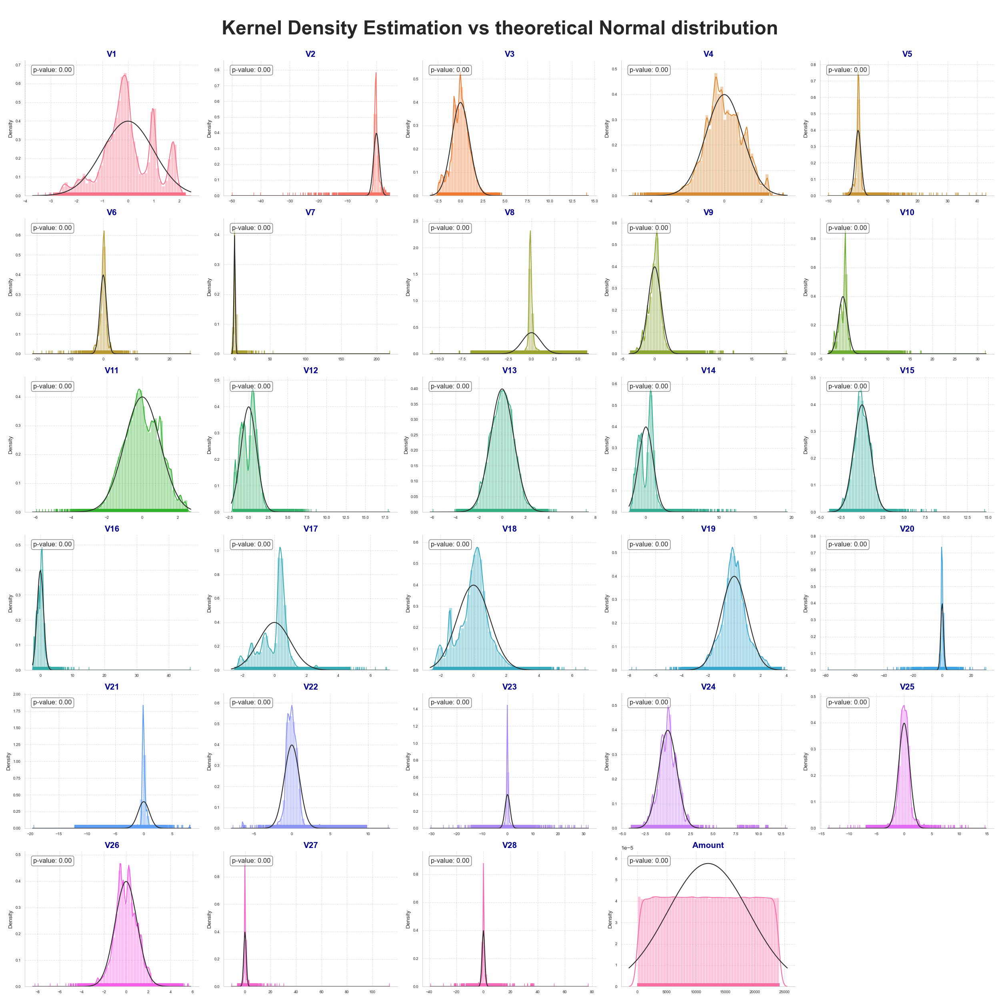

In [42]:
# Check if the plot has already been executed and saved in the current directory
if not os.path.exists('KDE_Plot.png'):
    kde_plot(ds.iloc[:, :-1])
else:
    display(Image(filename='KDE_Plot.png'))

In order to visualise the deviation from the normal variable more clearly, we have also proposed through the `qq_plot` function, a **QQ-plot** always accompanied by the p-value of the **Shapiro-Wilk** test. 

From here it is more evident how all the variables deviate from the theoretical distribution predominantly in the extreme quantiles

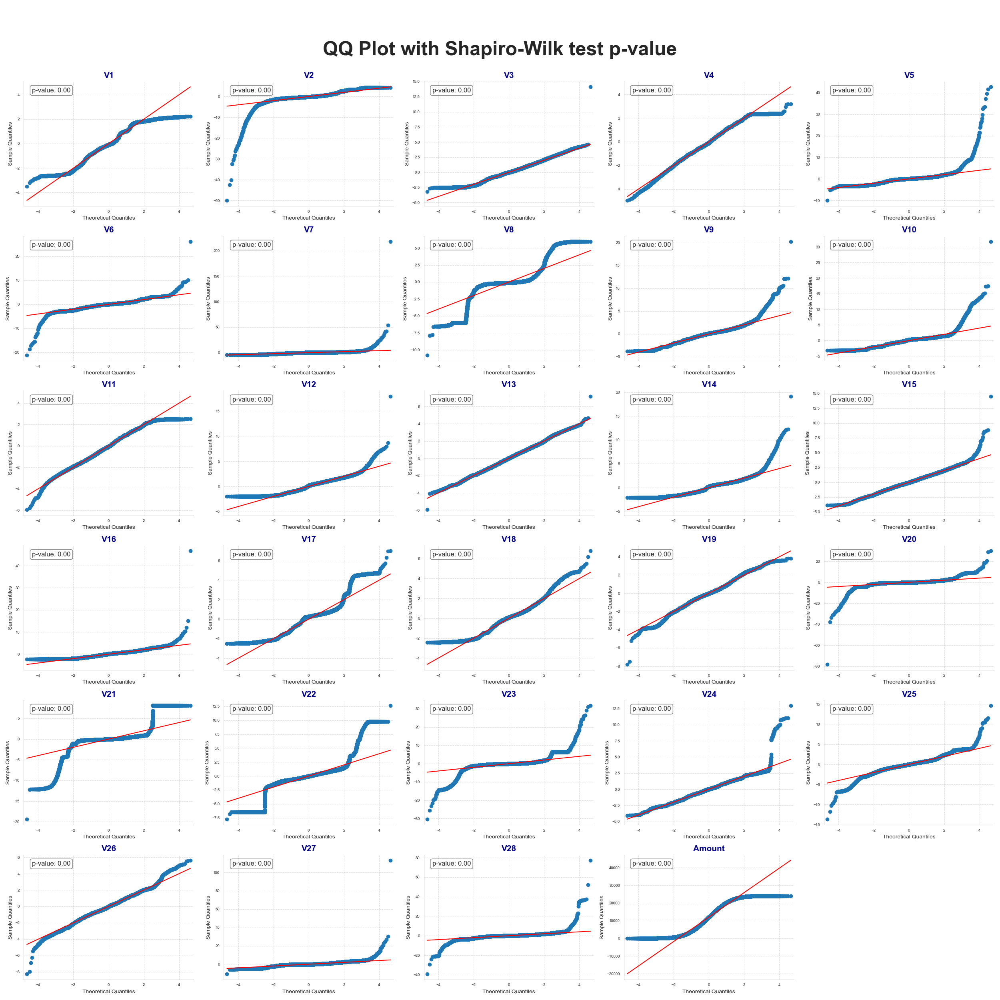

In [7]:
# Check if the plot has already been executed and saved in the current directory
if not os.path.exists('QQ_Plot.png'):
    qq_plot(ds.iloc[:, :-1])
else:
    display(Image(filename='QQ_Plot.png'))

### <code style="background:purple;color:white">**Distributions of the Fraudolent and Valid Transactions**</code>  

As a final univariate analysis, we decided to present, via our `violin_plot` function, a **violin plot** of the same variables but this time dividing them into the two classes. From this we can clearly see that many of these variables are characterised by many outliers or by a clearly larger first/fourth quartile than the boxplot shown in grey. 

By superimposing the median with the mean (highlighted by the purple rhombus) we again emphasise how the distributions tend to be quite symmetrical even when divided by class. 

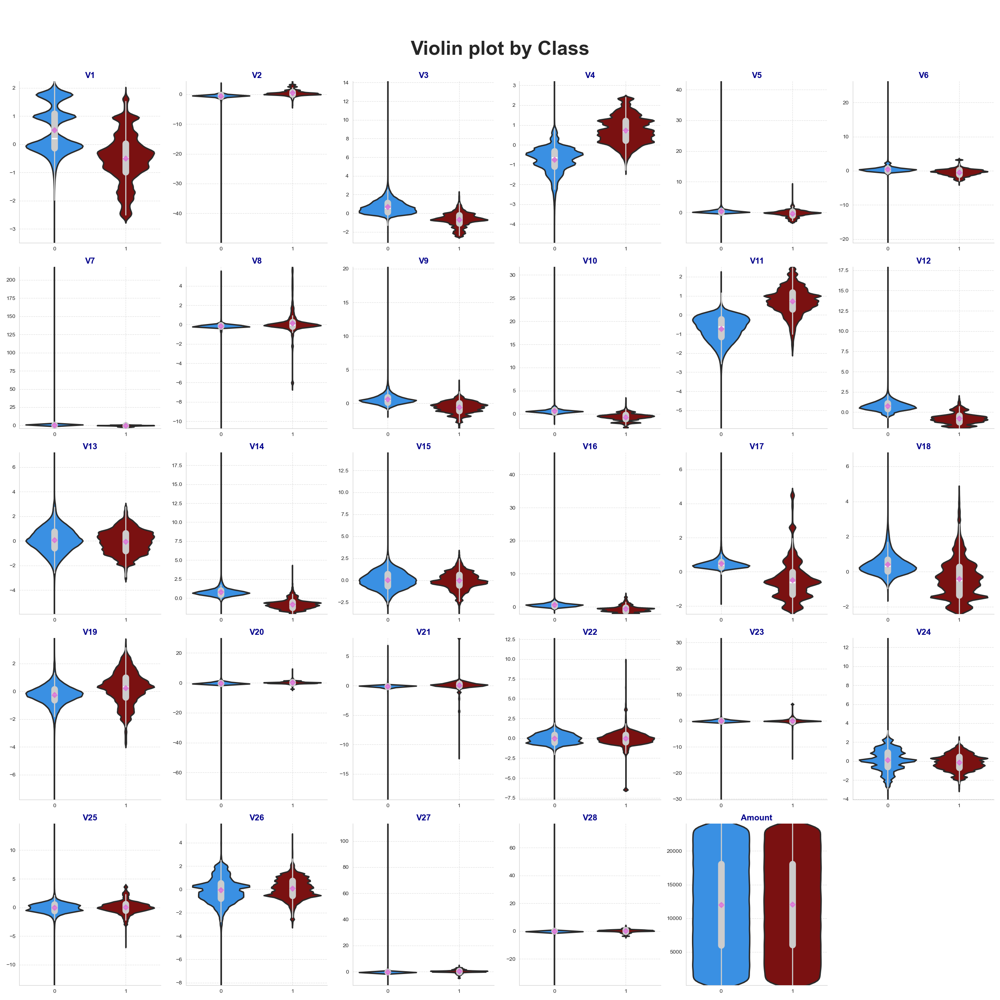

In [8]:
# Check if the plot has already been executed and saved in the current directory
if not os.path.exists('Violin_Plot.png'):
    # Violin plot of the features by 'class'
    violin_plot(ds) 
else:
    display(Image(filename='Violin_Plot.png'))

### <code style="background:purple;color:white">**Scatterplots**</code>  

In order to get a first visual impression of the relationship between the various variables we decided to display all possible pairs of scatterplots which for execution reasons use only a 5000 row sample. 

Through it we immediately notice how almost no pairs of variables exhibit linear or non-linear relationships despite the fact that the points in the plane have also been colored for the class to which they belong (fraudulent transactions or valid transactions). 

In [3]:
# Check if the plot has already been executed and saved in the current directory
if not os.path.exists('scatter.png'):
    # Scatter plot of the features
    # since the dataset is large we will sample 5000 points
    sns.pairplot(ds.sample(5000), hue='Class', markers=['o', 's'], palette='viridis', height=3, aspect=1.5)
    plt.savefig('scatter.png')
    plt.show()
else:
    display(Image(filename='scatter.png'))

### <code style="background:purple;color:white">**Correlation Matrix**</code>  

Wanting to focus more on linear relationships between pairs of variables, we performed and visualized via the appropriate `corr_matrix` function all **correlation coefficients**. Through this matrix we have a confirmation of what we saw before, that is, that the many of the variables are uncorrelated or weakly correlated (variables 19 to 28 + the variable Amount) with a few exceptions, present mainly between variable 1 to 18, which sometimes have stronger linear relationships.

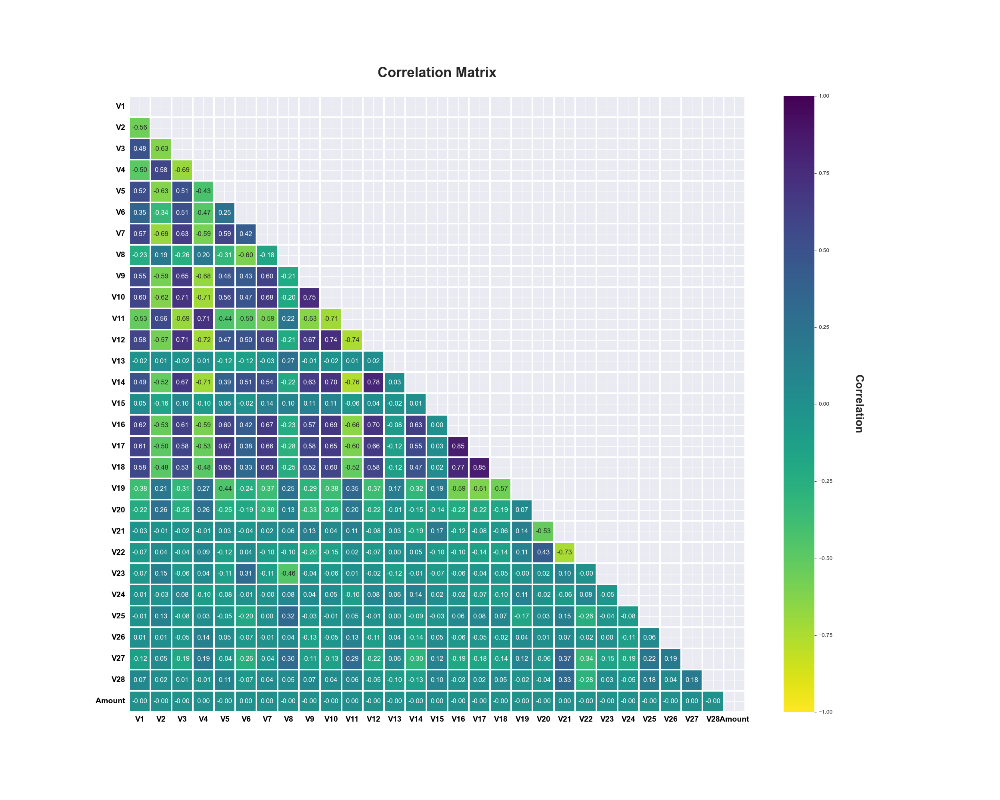

In [41]:
# Check if the plot has already been executed and saved in the current directory
if not os.path.exists('Correlation_Matrix.png'):
    # Correlation matrix
    corr_matrix(ds.iloc[:, :-1])
else:
    display(Image(filename='Correlation_Matrix.png'))

---

## <h2 style="text-align: center;">**Principal Component Analysis**</h2>

---

### <code style="background:darkcyan;color:white">**Scree Plot and Principal Component choice**</code>  

In [4]:
# Create a PCA model with the 'prince' package
pca = PCA(
    n_components=ds.iloc[:, :-1].shape[1],  # Extract all the principal components (PC) --> to choose the optimal value based on the Scree Plot
    n_iter=3,                        # Number of iterations for the power method to compute eigenvectors
    rescale_with_mean=True,          # Rescale the data by subtracting the mean
    rescale_with_std=True,           # Rescale the data by dividing by the standard deviation
    copy=True,                       # Use a copy of the dataset in order to prevent side-effects on the input data
    check_input=True,                # Check the consistency of the dataset --> for istance: dtype, non-empty, etc.
    engine='sklearn',                # PCA algorithm engine 
    random_state=30                  # Seed for reproducibility of the result since the prince package use a randomised version of SVD 
                                     # which is faster than the standard SVD
)

# Fit the PCA model to the features set 
pca = pca.fit(ds.iloc[:, :-1])

# Print a summary of the eigenvalues
pca.eigenvalues_summary

,eigenvalue,% of variance,% of variance (cumulative)
component,,,
0,9.823,33.87%,33.87%
1,2.810,9.69%,43.56%
2,1.920,6.62%,50.18%
3,1.841,6.35%,56.53%
4,1.293,4.46%,60.99%
5,1.063,3.67%,64.65%
6,1.003,3.46%,68.11%
7,0.998,3.44%,71.55%
8,0.870,3.00%,74.55%


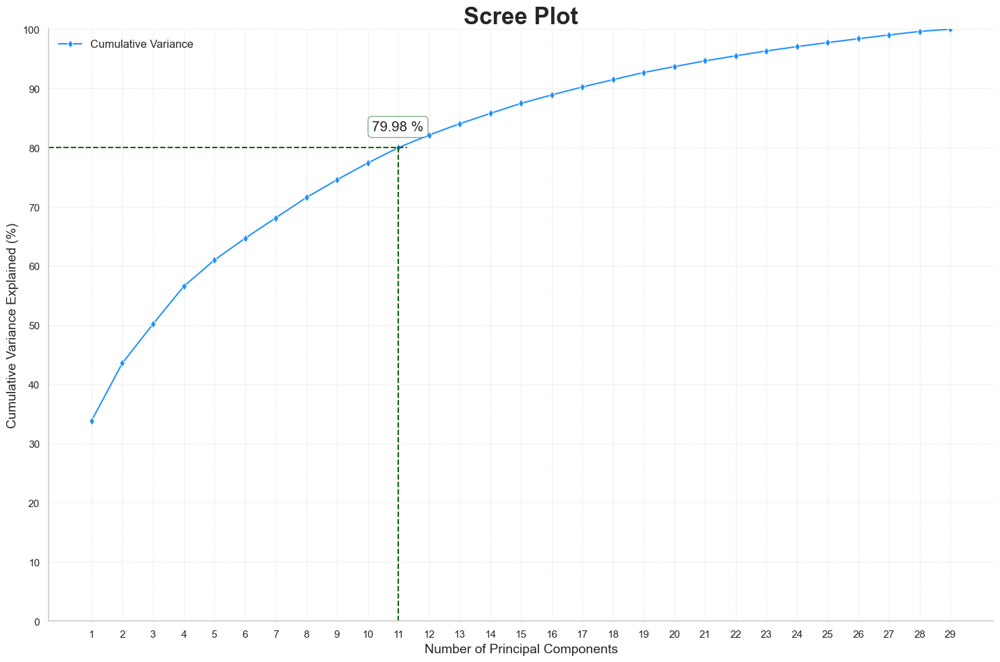

In [5]:
# Plot the Scree Plot
scree_plot(pca.cumulative_percentage_of_variance_, 11)

### <code style="background:darkcyan;color:white">**Variable Communalities**</code>  

In [14]:
# Create a PCA model with the 'prince' package
pca = PCA(
    n_components=11,            # Extract the first 3 principal components (PC) [optimal choice]
    n_iter=3,                   # Number of iterations for the power method to compute eigenvectors
    rescale_with_mean=True,     # Rescale the data by subtracting the mean
    rescale_with_std=True,      # Rescale the data by dividing by the standard deviation
    copy=True,                  # Use a copy of the dataset in order to prevent side-effects on the input data
    check_input=True,           # Check the consistency of the dataset --> for istance: dtype, non-empty, etc.
    engine='sklearn',           # PCA algorithm engine 
    random_state=30             # Seed for reproducibility of the result since the prince package use a randomised version of SVD 
                                # which is faster than the standard SVD
)
# Fit the PCA model to the quantitative dataset
pca = pca.fit(ds.iloc[:, :-1])

# Calculate communalities as the sum of squared column coordinates
communalities = (pca.column_coordinates_ ** 2).sum(axis=1)

# Create a DataFrame to visualize the results
communalities_df = pd.DataFrame(index=ds.iloc[:, :-1].columns, data={'Communality': communalities})

# Sort the DataFrame in descending order of Communality
communalities_df = communalities_df.sort_values(by='Communality', ascending=False).reset_index()

# Rename the index as Variable
communalities_df = communalities_df.rename(columns={'index': 'Variable'})

# Plot the Communalities
communalities_df.style.background_gradient(cmap='viridis')

,Variable,Communality
0,Amount,0.999703
1,V15,0.961217
2,V13,0.958667
3,V26,0.928140
4,V28,0.912971
5,V24,0.887172
6,V17,0.876353
7,V21,0.872501
8,V16,0.827392
9,V8,0.823582


### <code style="background:darkcyan;color:white">**Factor Pattern**</code>  

In [15]:
# Factor pattern
round(pca.column_correlations, 2)

component,0,1,2,3,4,5,6,7,8,9,10
variable,,,,,,,,,,,
V1,0.72,0.06,0.03,-0.12,0.11,0.02,-0.01,-0.00,0.10,0.12,-0.11
V2,-0.73,-0.08,-0.16,-0.13,-0.35,0.05,-0.04,-0.04,0.01,-0.12,-0.11
V3,0.81,-0.03,0.08,0.17,0.04,0.00,-0.08,-0.07,0.00,0.04,0.10
V4,-0.79,0.00,-0.12,-0.25,0.12,0.02,0.11,0.08,0.08,-0.03,-0.12
V5,0.70,0.16,-0.07,-0.25,0.31,-0.10,0.14,0.12,0.11,0.13,-0.04
V6,0.59,-0.27,-0.43,0.27,-0.00,0.14,-0.13,-0.11,-0.06,0.01,0.08
V7,0.80,0.14,0.09,-0.03,0.18,-0.01,0.00,-0.00,-0.00,0.01,0.01
V8,-0.36,0.34,0.73,-0.09,-0.17,-0.02,-0.05,-0.04,-0.04,-0.06,0.03
V9,0.79,0.14,0.05,0.21,-0.07,-0.02,-0.03,-0.02,-0.08,0.10,0.02


In [18]:
# Obtain the PCA dataset
pca_df = pca.fit_transform(ds.iloc[:, :-1])

# Rename the PC
pca_df = pca_df.rename(columns={i: f'PC {i+1}' for i in range(pca_df.shape[1])})
pca_df.columns.name = None

# Save the PCA dataset
pca_df.to_csv('pca_df.csv', index=False)

pca_df.head(5)

,PC 1,PC 2,PC 3,PC 4,PC 5,PC 6,PC 7,PC 8,PC 9,PC 10,PC 11
id,,,,,,,,,,,
0,2.190567,-0.164029,0.262822,0.911543,0.489863,-1.354453,-0.096963,-1.181035,-0.746519,-1.095689,0.197111
1,2.085246,0.355043,0.169833,0.019881,0.123452,0.631813,-0.890775,0.301329,-0.295979,-0.341627,-0.648183
2,2.283195,-0.522323,-0.362215,0.381167,1.141663,-0.152801,-1.803094,0.304586,-1.535825,-1.240460,-1.844366
3,2.694943,0.107423,-0.256499,-1.141419,-0.684173,1.158768,-0.822529,0.530346,-1.477775,0.372560,-0.005046
4,2.048883,-0.354252,0.936233,0.978828,0.597368,0.897456,-0.777743,-1.026307,0.619814,0.617934,-0.362185


From the PCA analysis we can see that the first $11$ components are able to explain $\sim 80\%$ of the total variance of the data. From this result we expect that the feature importance plots of the models will show that only a small number of features are highly important for the classification of the data.

---

## <h2 style="text-align: center;">**Classification Models**</h2>

---

First, before starting to train our models, we divided the dataset into **Training** and **Test sets** using the proportion 80:20. We then checked that the two classes were balanced in both sets so that our models were not affected by systematic errors due to the rarity of fraudulent transactions compared to valid ones.

- Train set: 454904 observations
- Test set: 113726 observations


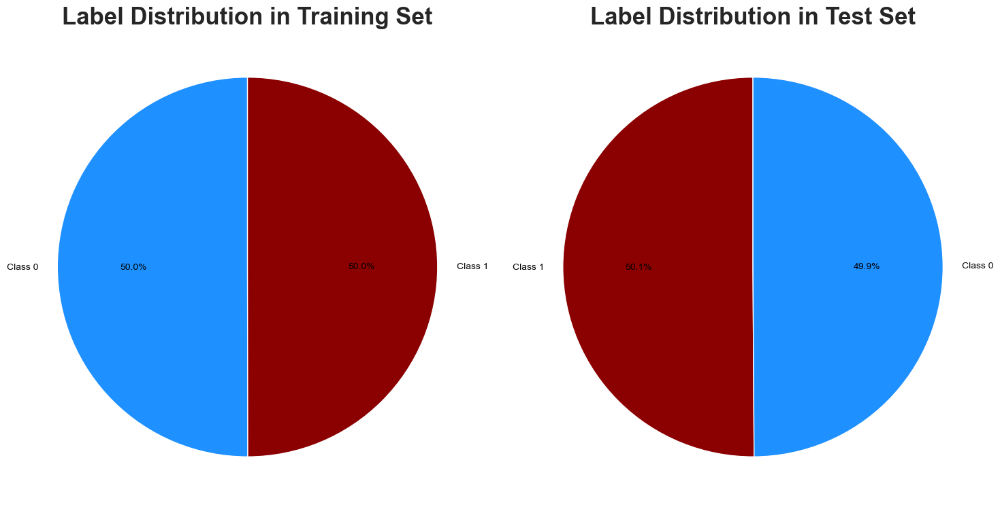

In [3]:
# Normalization of the train features
scaler = StandardScaler()
df = pd.DataFrame(scaler.fit_transform(ds.iloc[:, :-1]), columns=ds.columns[:-1])

# Add the target variable to the normalized dataset
df['target'] = ds['Class']

# Split the dataset into training and testing sets
x_train, x_test, y_train, y_test = train_test_split(df.iloc[:, :-1], df.iloc[:, -1], test_size=0.2, random_state=42)

# Show the length of each set
print(f'- Train set: {x_train.shape[0]} observations\n- Test set: {x_test.shape[0]} observations')

# Visiualize the proportion of the target variable in the training and testing sets
label_proportion(y_train, y_test)

### <code style="background:royalblue;color:white">**Logistic Regression**</code>  

As a first approach for this binary classification problem, we decided to use the simplest model of all, i.e. **logistic regression** in order to also use it as a benchmark for comparison with more complex models.

The Logistic regression is a linear model that models the relationship between the input features $X$ and the probability of a binary outcome $y \in \{0, 1\}$ by employing the logistic (sigmoid) function. The model predict the probability of the input belonging to the class 1 by using the following formula:

$$ P(y=1|X) = \frac{1}{1 + e^{-(\beta_0 + \beta^TX)}} $$

where $\beta$ are the coefficients of the input features $X$ learned during the training phase, $\beta_0$ is the intercept and $\sigma(z) = 1/(1+e^{-z})$ is the logistic function.

The model is trained by maximizing the **log likelihood** function of the observed data which is equivalent to minimizing the **cross-entropy** loss function given by:

$$ L(\beta) = -\sum_{i=1}^{n} y_i \log(P(y=1|X_i)) + (1-y_i) \log(1-P(y=1|X_i)) $$

In [26]:
# Model initialization
model = LogisticRegression(random_state=42, max_iter=1000)

# Model training
start = time.time()
model.fit(x_train, y_train)
end = time.time()

print(f"- \033[95mTraining time:\033[0m {end - start:.2f} s")

- Training time: 1.07 s


As we can se, given the simplicity of the model, the trainig phase is very fast. 

In order to evaluate our model we decided to print the **confusion matrix** of both sets and a table which summarises all the main metrics that can be computed by it. All these operations were performed through our `model_metrics` function.

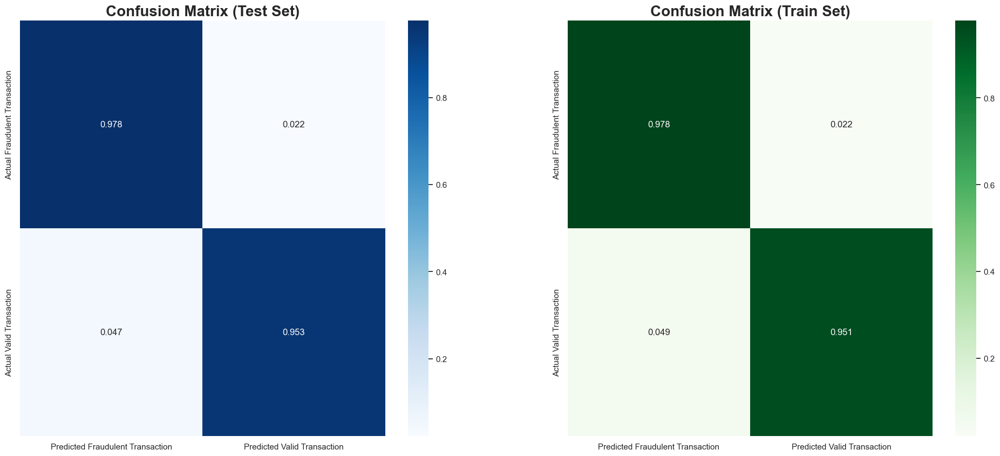

+------------------------------------------+
|              Model Metrics               |
+-----------+----------+-----------+-------+
|   Metric  | Test Set | Train Set | Delta |
+-----------+----------+-----------+-------+
|  Accuracy |  0.965   |   0.965   | 0.000 |
| Precision |  0.977   |   0.978   | 0.000 |
|   Recall  |  0.953   |   0.951   | 0.001 |
|  F1 Score |  0.965   |   0.964   | 0.000 |
+-----------+----------+-----------+-------+


In [27]:
model_metrics(y_train, y_test, model.predict(x_train), model.predict(x_test))

Unexpectedly, even this simple motorbike model manages to achieve remarkable scores in all metrics characterised also by an almost zero delta between their value in the two sets. 

Below, using the `feature_importance` function, we printed out a graph with the coefficients of the model in order to see which variable contributes the most for each class. In this case, we can see that variables 4 and 11 contribute positively for fraudulent transactions (positive coefficient), whereas variables 14, 8, 12, 17 and 10 contribute

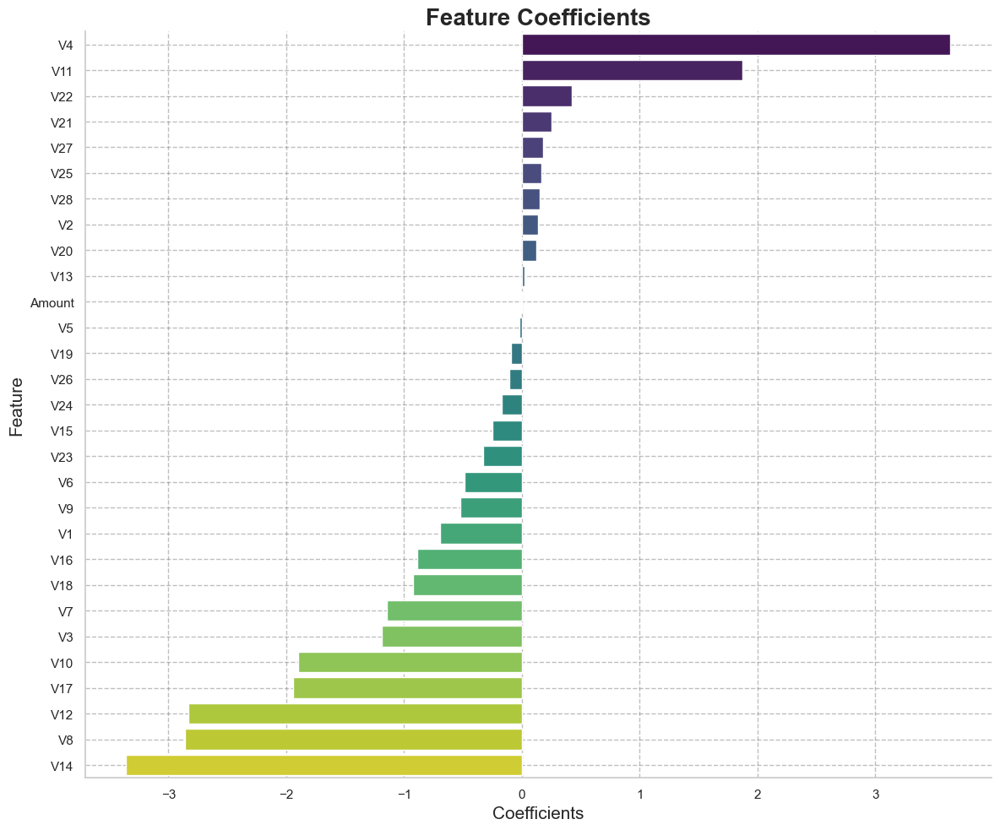

In [28]:
feature_importances(model.coef_[0], 'Logistic Regression')

### <code style="background:royalblue;color:white">**Support Vector Machine Classifier**</code>  

The **Support Vector Classifier (SVC)** is a supervised learning algorithm that belongs to the family of Support Vector Machines (SVMs) and is designed to find the optimal hyperplane that separates data points of different classes maximizing the margins. This, in contrast to the logistic regression, can perform well even in the presence of non-linear relationships between the input features thanks to the use of non-linear kernels.

The SVC aims to solve the following optimization problem for the linear separable case:

$$ \begin{align*} 
\min_{\mathbf{w}, b, \xi} \quad & \frac{1}{2} ||\mathbf{w}||^2 + C\sum_{i=1}^n \xi_i \quad \text{subject to} \quad & y_i (\mathbf{w}^\top \phi(\mathbf{X}_i) + b) \geq 1-\xi_i, \quad \forall i = 1, \dots, n \quad \&  \quad \xi_i \geq 0 
\end{align*} $$

Where, ($\mathbf{w}$) is the weight vector normal to the hyperplane, ($b$) is the bias term, $\phi(X_i)$ is the feature mapping function and $C$ is the regularization parameter.

In order to find the optimal hyperparameters for the model, we decided to perform a **Grid Search** with **5-fold cross-validation** using the accuracy as evaluation metric. The hyperparameters we decided to tune are the **kernel** type, the **C** regularization parameter and the **kernel coefficent** of the rbf kernel. 

To speed up the process we decided to perform the search in parallel on 6 cores (save at least 1 or 2 core of the computer for safety reasons).

#### <code style="background:Darkred;color:white">**/!\ High Execution Time**</code>  

In [6]:
grid = {'C': [0.1, 1, 10],
        'kernel': ['linear', 'rbf'],
        'gamma': ['scale', 'auto']
}

# Grid search Cross-Validation
svc_cv = GridSearchCV(SVC(), grid, cv=5, n_jobs=6, verbose=1, scoring='accuracy')

# CV training
start = time.time()
svc_cv.fit(x_train, y_train)
end = time.time()

print(f"\n- \033[95mCross-Validation time:\033[0m {end - start:.2f} s\n")
print(f"- \033[92mBest parameters:\033[0m {svc_cv.best_params_} \033[92mwith a score of\033[0m {svc_cv.best_score_:.2f}")

Fitting 5 folds for each of 12 candidates, totalling 60 fits

- Cross-Validation time: 69376.00 s

- Best parameters: {'C': 10, 'gamma': 'scale', 'kernel': 'rbf'} with a score of 1.00


Even though we parallelized the process and reduced the search grid to the minimum, it took us more than 19 hours to complete the entire process for this model. This certainly is a huge drawback in the **model selection** phase.

Finally, having found the optimal parameters we trained the final model and saved it locally in the notebook directory in order not to have to repeat the process a second time

In [7]:
# Check if the model has already been trained and saved in the current directory
if not os.path.exists('svc_model.pkl'):
    # Model initialization
    model = SVC(**svc_cv.best_params_, random_state=42)

    # Model training
    start = time.time()
    model.fit(x_train, y_train)
    end = time.time()

    print(f"- \033[95mTraining time:\033[0m {end - start:.2f} s")
    
    # Save the trained model to disk
    joblib.dump(model, 'svc_model.pkl')
    print(f"- \033[92mSVC model successfully trained and saved to disk\033[0m")
else:
    # If the model has already been trained, load it from disk
    model = joblib.load('svc_model.pkl')
    print(f"- \033[92mPre-trained SVC model successfully loaded\033[0m")

- Training time: 510.03 s
- SVC model successfully trained and saved to disk


From the cross validation we already knew that the accuracy of the model would be maximum but from the confusion matrix and the metrics table we can see that all the metrics also reached the maximum value

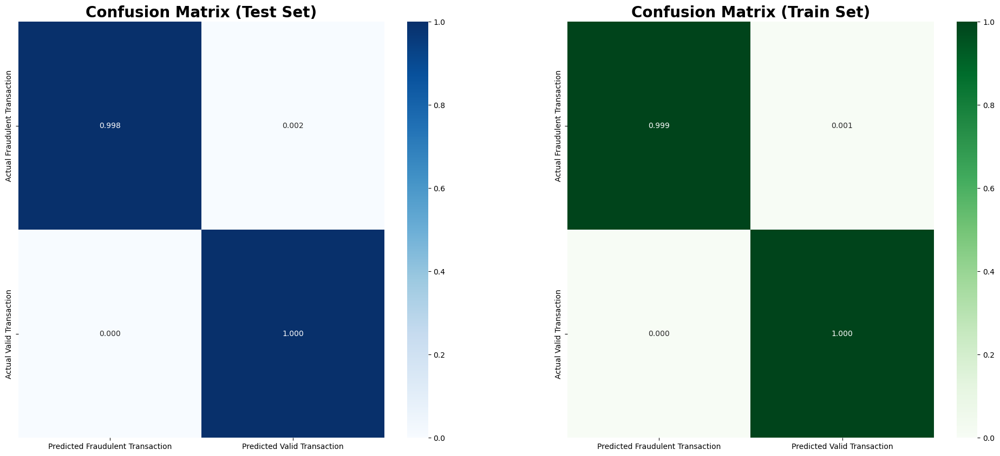

+------------------------------------------+
|              Model Metrics               |
+-----------+----------+-----------+-------+
|   Metric  | Test Set | Train Set | Delta |
+-----------+----------+-----------+-------+
|  Accuracy |  0.999   |   0.999   | 0.000 |
| Precision |  0.998   |   0.999   | 0.000 |
|   Recall  |  1.000   |   1.000   | 0.000 |
|  F1 Score |  0.999   |   0.999   | 0.000 |
+-----------+----------+-----------+-------+


In [8]:
model_metrics(y_train, y_test, model.predict(x_train), model.predict(x_test))

#### <code style="background:Darkred;color:white">**/!\ Important Note**</code>  

Since we have used a non linear kernel in the final model (after the Cross-Validation Hypertuning), the model is not interpretable in terms of the coefficients of the features that in this case are not linearly related to the target variable. 

### <code style="background:royalblue;color:white">**Random Forest**</code>  

**Random Forest** is an ensemble method that combines multiple decision trees, trained on different random subsets of data (Bagging) sampled with replacements, to improve generalization and reduce variance. The final outputs of the classifier is the class that is the mode of the classes of the individual trees:

$$ \hat{y} = \text{Mode}\{h_1(\mathbf{X}), ..., h_n(\mathbf{X}) \} $$

where $h_i(\mathbf{X})$ is the prediction of the $i-th$ tree and $n$ is the total number of trees in the forest.

The Random Forest algorithm is able to handle non-linear relationships between the input features and the target variable and is also able to capture interactions between them.

In order to find the optimal hyperparameters for the model, we decided to perform a **Grid Search** with **5-fold cross-validation** using the accuracy as evaluation metric. 

The hyperparameters we decided to tune are the **number of trees** in the forest, the **maximum number of features** to consider when looking for the best split, the **maximum depth** of the trees, the **minimum number of samples** required to split an internal node and the **minimum number of samples** required to be at a leaf node.

To speed up the process we decided to perform the search in parallel on 6 cores (save at least 1 or 2 core of the computer for safety reasons).

#### <code style="background:Darkred;color:white">**/!\ High Execution Time**</code>  

In [27]:
grid = {'n_estimators': [50, 100],
        'max_features': ['sqrt', 'log2'],
        'max_depth': [None, 10],
        'min_samples_split': [2, 5],
        'min_samples_leaf': [1, 2]
}

# Grid search Cross-Validation
rf_cv = GridSearchCV(RandomForestClassifier(), grid, cv=5, n_jobs=6, verbose=1, scoring='accuracy')

# CV training
start = time.time()
rf_cv.fit(x_train, y_train)
end = time.time()

print(f"\n- \033[95mCross-Validation time:\033[0m {end - start:.2f} s\n")
print(f"- \033[92mBest parameters:\033[0m {rf_cv.best_params_} \033[92mwith a score of\033[0m {rf_cv.best_score_:.2f}")

Fitting 5 folds for each of 32 candidates, totalling 160 fits

- Cross-Validation time: 3828.08 s

- Best parameters: {'max_depth': None, 'max_features': 'log2', 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 50} with a score of 1.00


This time the hypertining process took us approximately 1 hour which is a significant improvement compared to the previous model but still a long time.

Finally, having found the optimal parameters we trained the final model and saved it locally in the notebook directory in order not to have to repeat the process a second time

In [28]:
# Check if the model has already been trained and saved in the current directory
if not os.path.exists('RandForest_model.pkl'):
    # Model initialization
    model = RandomForestClassifier(**rf_cv.best_params_)

    # Model training
    start = time.time()
    model.fit(x_train, y_train)
    end = time.time()

    print(f"- \033[95mTraining time:\033[0m {end - start:.2f} s")
    
    # Save the trained model to disk
    joblib.dump(model, 'RandForest_model.pkl')
    print(f"- \033[92mRandom Forest model successfully trained and saved to disk\033[0m")
else:
    # If the model has already been trained, load it from disk
    model = joblib.load('RandForest_model.pkl')
    print(f"- \033[92mPre-trained Random Forest model successfully loaded\033[0m")

- Training time: 109.03 s
- Random Forest model successfully trained and saved to disk


From the cross validation we already knew that the accuracy of the model would be maximum but from the confusion matrix and the metrics table we can see that all the metrics also reached the maximum value

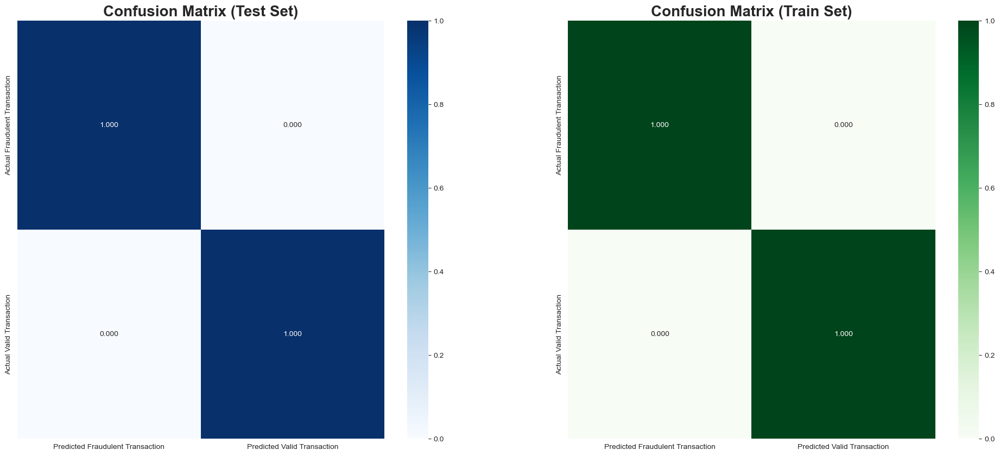

+------------------------------------------+
|              Model Metrics               |
+-----------+----------+-----------+-------+
|   Metric  | Test Set | Train Set | Delta |
+-----------+----------+-----------+-------+
|  Accuracy |  1.000   |   1.000   | 0.000 |
| Precision |  1.000   |   1.000   | 0.000 |
|   Recall  |  1.000   |   1.000   | 0.000 |
|  F1 Score |  1.000   |   1.000   | 0.000 |
+-----------+----------+-----------+-------+


In [29]:
model_metrics(y_train, y_test, model.predict(x_train), model.predict(x_test))

Plotting the feature importance graph we can see that the most important features are 14, 10, 17 and 4 which were also very important in the logistic regression model but not with the same "weight".

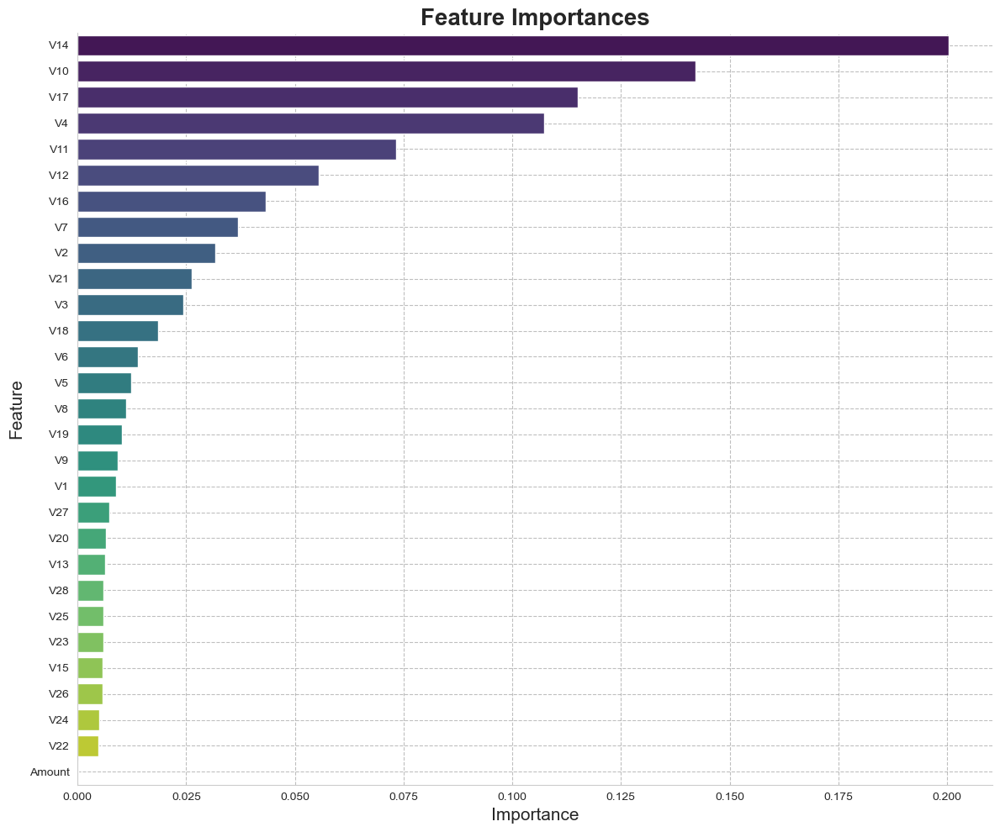

In [30]:
feature_importances(model.feature_importances_)

### <code style="background:royalblue;color:white">**Extra Tree Classifier**</code>  

The **Extra Trees (Extremely Randomized Trees) Classifier** is also an ensembled method very similar to Random Forest but introduces additional randomness by splitting nodes with random thresholds, rather than optimal ones. The result of this increased randomness is faster training and slightly higher bias, often reducing variance further.

In order to find the optimal hyperparameters for the model, we decided to perform a **Grid Search** with **5-fold cross-validation** using the accuracy as evaluation metric. 

The hyperparameters grid used is the same as the one used for the Random Forest model in order to make a fair comparison between the two models.

To speed up the process we decided to perform the search in parallel on 6 cores (save at least 1 or 2 core of the computer for safety reasons).

In [ ]:
grid = {'n_estimators': [50, 100],
    'max_features': ['log2', 'sqrt'],
    'max_depth': [None, 10],
    'min_samples_split': [2, 5],
    'min_samples_leaf': [1, 2]}

# Grid search Cross-Validation
etc_cv = GridSearchCV(ExtraTreesClassifier(), grid, cv=5, n_jobs=6, verbose=1, scoring='accuracy')

# CV training
start = time.time()
etc_cv.fit(x_train, y_train)
end = time.time()

print(f"\n- \033[95mCross-Validation time:\033[0m {end - start:.2f} s\n")
print(f"- \033[92mBest parameters:\033[0m {etc_cv.best_params_} \033[92mwith a score of\033[0m {etc_cv.best_score_:.2f}")


- Cross-Validation time: 377.53 s

- Best parameters: {'max_depth': None, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 100} with a score of 1.00


This time the hypertining process took us only 6 minutes which is a significant improvement compared to Random Forest model given also the fact that we used the same grid search parameters. Obviously, given the nature of the model which is usually faster than the Random Forest, we expected this result. 

Finally, having found the optimal parameters we trained the final model and saved it locally in the notebook directory in order not to have to repeat the process a second time

In [ ]:
# Check if the model has already been trained and saved in the current directory
if not os.path.exists('ExTree_model.pkl'):
    # Model initialization
    model = ExtraTreesClassifier(**etc_cv.best_params_)

    # Model training
    start = time.time()
    model.fit(x_train, y_train)
    end = time.time()

    print(f"- \033[95mTraining time:\033[0m {end - start:.2f} s")
    
    # Save the trained model to disk
    joblib.dump(model, 'ExTree_model.pkl')
    print(f"- \033[92mExtra Tree Classifier model successfully trained and saved to disk\033[0m")
else:
    # If the model has already been trained, load it from disk
    model = joblib.load('ExTree_model.pkl')
    print(f"- \033[92mPre-trained Extra Tree Classifier model successfully loaded\033[0m")

- Training time: 23.75 s
- Extra Tree Classifier model successfully trained and saved to disk


From the cross validation we already knew that the accuracy of the model would be maximum but from the confusion matrix and the metrics table we can see that all the metrics also reached the maximum value.

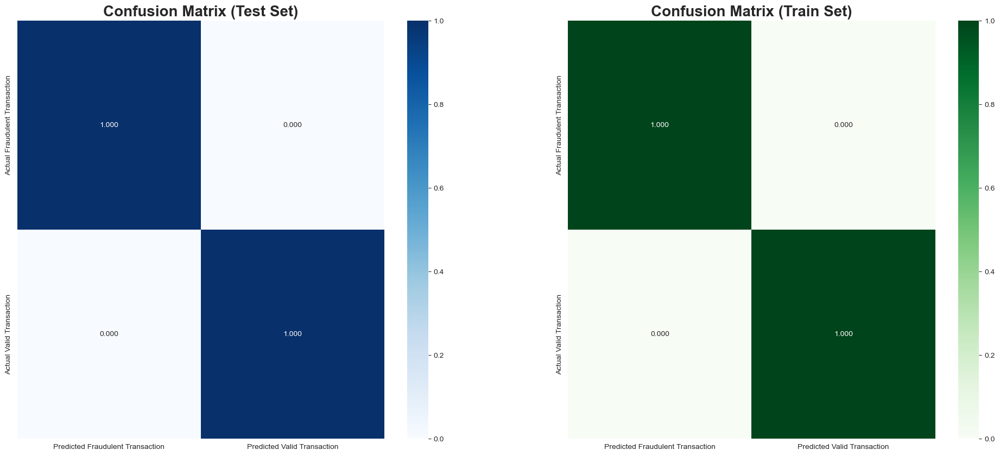

+------------------------------------------+
|              Model Metrics               |
+-----------+----------+-----------+-------+
|   Metric  | Test Set | Train Set | Delta |
+-----------+----------+-----------+-------+
|  Accuracy |  1.000   |   1.000   | 0.000 |
| Precision |  1.000   |   1.000   | 0.000 |
|   Recall  |  1.000   |   1.000   | 0.000 |
|  F1 Score |  1.000   |   1.000   | 0.000 |
+-----------+----------+-----------+-------+


In [17]:
model_metrics(y_train, y_test, model.predict(x_train), model.predict(x_test))

This time the feature importance graph shows that the model considers much more variable "important" (i.e. with a high "weight") than the one for the Random Forest.

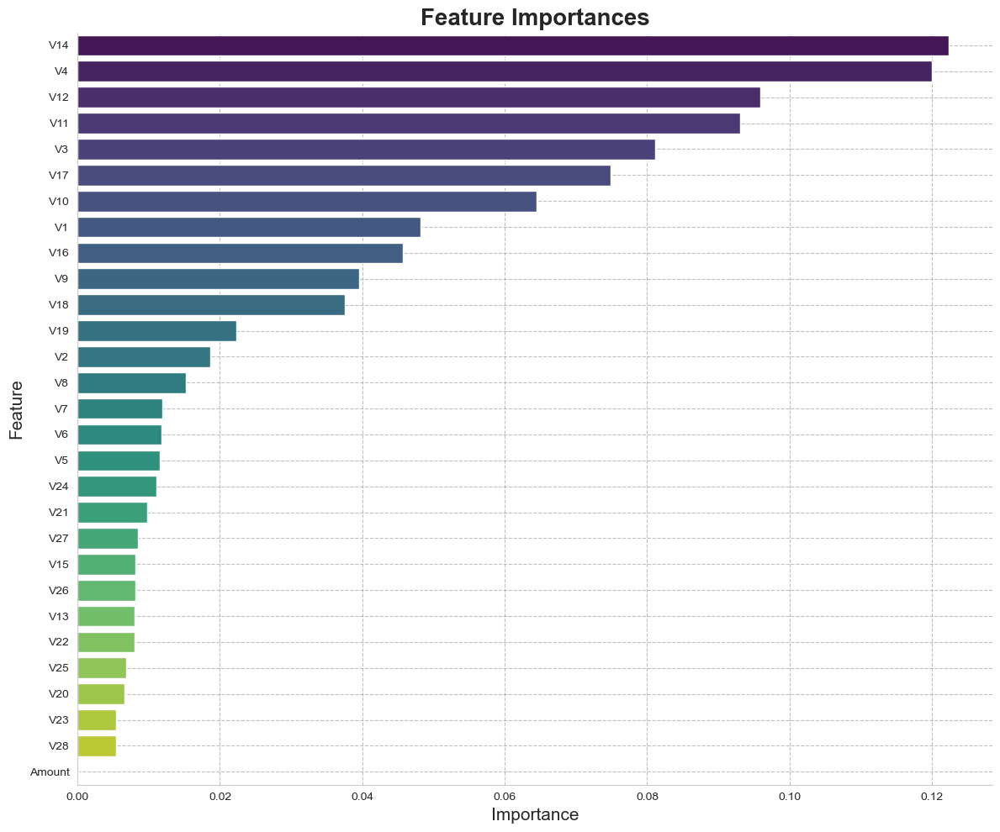

In [18]:
feature_importances(model.feature_importances_)

### <code style="background:royalblue;color:white">**XGBoost**</code>  

XGBoost (eXtreme Gradient Boosting) is a highly efficient and scalable implementation of gradient boosting. Gradient Boosting builds an ensemble of decision trees sequentially, where each tree corrects the errors of its predecessors given more weight to the observations that were misclassified in the previous trees. In onther words, the model prediction at the $t-th$ iteration is given by:

$$ \hat{y}_i^{(t)} = \hat{y}_i^{(t-1)} + f_t(\mathbf{X}_i) $$

where $f_t$ is the $t-th$ tree in the ensemble.

The objective function to minimize through **Gradient Descent** is the following:

$$ \mathcal{L} = \sum_{i=1}^n \ell(y_i, \hat{y}_i^{(t)}) + \sum{k=1}^t \Omega(f_k) $$

where $\ell$ is the loss function, $\hat{y}_i^{(t)}$ is the prediction of the model at the $t-th$ iteration, $\Omega(f_k)$ is the regularization term and $f_k$ is the $k-th$ tree in the ensemble. 

The regularization term is used to prevent overfitting and is a function of the complexity of the tree:

$$ \Omega(f) = \gamma T + \frac{1}{2} \lambda ||\mathbf{w}||^2 $$

where $T$ is the number of leaves in the tree, $w$ is the vector of leaf weights and $\gamma$ and $\lambda$ are the regularization parameters.

In order to find the optimal hyperparameters for the model, we decided to perform a **Grid Search** with **5-fold cross-validation** using the accuracy as evaluation metric. 

The hyperparameters that we tuned are the **number of trees** in the ensemble, the **maximum depth** of the trees and the **learning rate** of the gradient descent.

To speed up the process we decided to perform the search in parallel on 6 cores (save at least 1 or 2 core of the computer for safety reasons).

In [ ]:
grid = {'n_estimators': [50,100,150,200],
        'learning_rate': [0.01, 0.1, ],
        'max_depth': [3, 5, 7]}

# Grid search Cross-Validation
xgb_cv = GridSearchCV(XGBClassifier(), grid, cv=5, n_jobs=6, verbose=1, scoring='accuracy')

# CV training
start = time.time()
xgb_cv.fit(x_train, y_train)
end = time.time()

print(f"\n- \033[95mCross-Validation time:\033[0m {end - start:.2f} s\n")
print(f"- \033[92mBest parameters:\033[0m {xgb_cv.best_params_} \033[92mwith a score of\033[0m {xgb_cv.best_score_:.2f}")

Fitting 5 folds for each of 24 candidates, totalling 120 fits

 - Cross-Validation time: 88.10 s

- Best parameters: {'learning_rate': 0.1, 'max_depth': 7, 'n_estimators': 200} with a score of 1.00


As expected this is the fastet model to train and hypertune, requiring only 1 minute and 22 seconds to find the optimal hyperparameters.

As usual we saved the final model locally in the notebook directory in order not to have to repeat the process a second time.

In [ ]:
# Check if the model has already been trained and saved in the current directory
if not os.path.exists('xgboost_model.pkl'):
    # Model initialization
    model = XGBClassifier(**xgb_cv.best_params_)

    # Model training
    start = time.time()
    model.fit(x_train, y_train)
    end = time.time()

    print(f"- \033[95mTraining time:\033[0m {end - start:.2f} s")
    
    # Save the trained model to disk
    joblib.dump(model, 'xgboost_model.pkl')
    print(f"- \033[92mXGBoost model successfully trained and saved to disk\033[0m")
else:
    # If the model has already been trained, load it from disk
    model = joblib.load('xgboost_model.pkl')
    print(f"- \033[92mPre-trained XGBoost model successfully loaded\033[0m")

- Training time: 2.37 s
- XGBoost model successfully trained and saved to disk


From the cross validation we already knew that the accuracy of the model would be maximum but from the confusion matrix and the metrics table we can see that all the metrics also reached the maximum value.

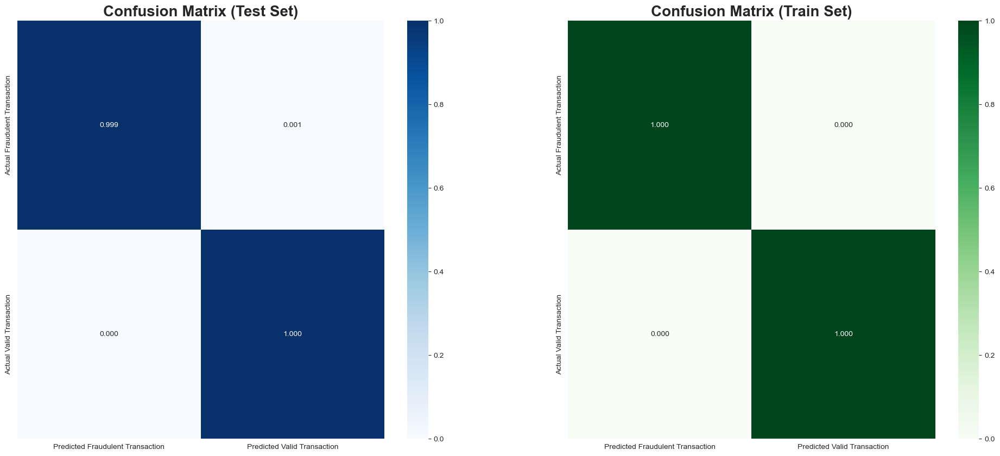

+------------------------------------------+
|              Model Metrics               |
+-----------+----------+-----------+-------+
|   Metric  | Test Set | Train Set | Delta |
+-----------+----------+-----------+-------+
|  Accuracy |  1.000   |   1.000   | 0.000 |
| Precision |  0.999   |   1.000   | 0.000 |
|   Recall  |  1.000   |   1.000   | 0.000 |
|  F1 Score |  1.000   |   1.000   | 0.000 |
+-----------+----------+-----------+-------+


In [21]:
model_metrics(y_train, y_test, model.predict(x_train), model.predict(x_test))

Here, from the feature importance graph, we can see that the model considers almost only the variable 14 as important for the classification of the two classes which is a very strange and different result especially compared to the previous models.

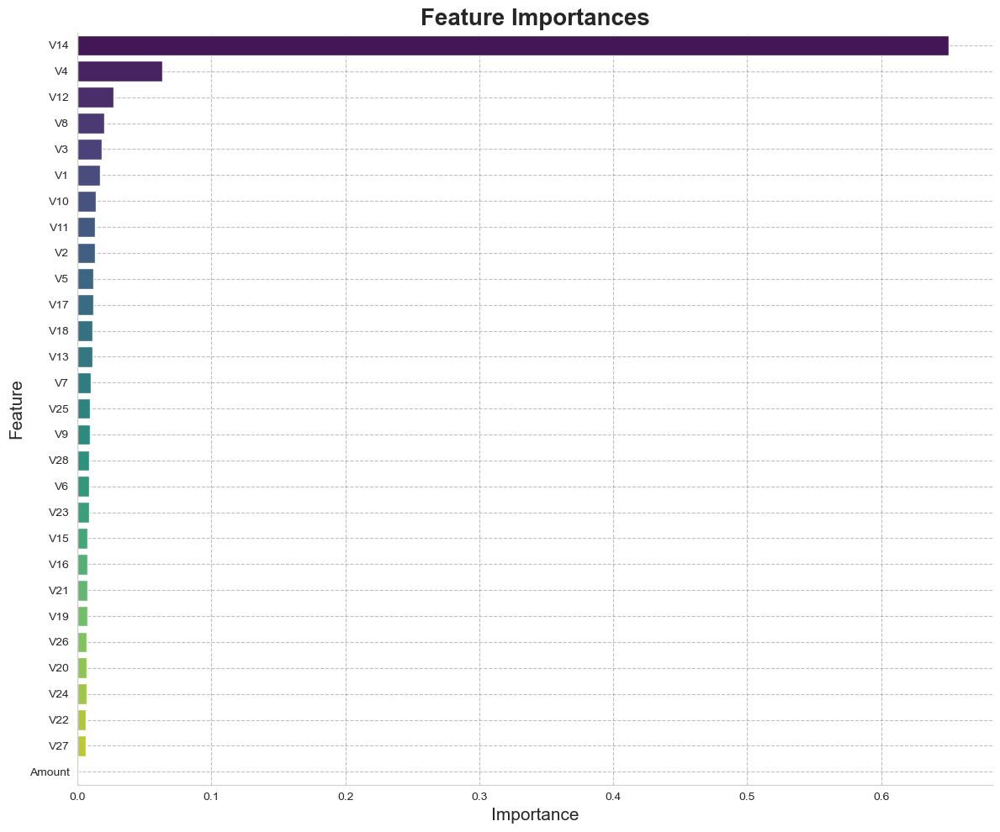

In [22]:
feature_importances(model.feature_importances_)

### <code style="background:royalblue;color:white">**JAX - Multi Layer Perceptron**</code>  

As last model, we decided to use a **Multi Layer Perceptron** written entirely with the `JAX` library in order to maximize its efficiency through vectorized operations and a precompilation of the model using the `jax.jit` (Just in Time compilation) decorator. This time since the model code is nontrivial and relatively complex we decided to leave it in view in the notebook accompanied by extensive and exhaustive comments that should make its structure clear.

Since the neural networks perform stochastic gradient descent we had to divide the dataset into **mini-batches** and after a couple of iteration of the model we found that the optimal batch size was 128. These batches were computed after a **shuffling** of the dataset in order to maximize the representativeness of the mini-batches. Lastly we decided to **prefetch** the data for memory optimization.

In [4]:
# Convert the data into the proper format
x_train, x_test = map(jnp.float32, [x_train, x_test])
y_train, y_test = map(jnp.int32, [y_train, y_test])

# Create a single dataset for the training set (used in the for loop of the training process) 
train_ds = tf.data.Dataset.from_tensor_slices((x_train, y_train))

# Shuffle, batch and prefetch the training set
batch_size = 128
train_batches = train_ds.shuffle(100, seed=456).batch(batch_size).prefetch(tf.data.AUTOTUNE)

We build the MLP model depending on the `number of layers` and the `number of units` in each layer. As **Activation Function** we chose a classic `RELU` at the end of each layer which applies the following operation on the output of each hidden unit:

$$ \text{RELU}(x) = \max(0, x) $$

As a loss function we chose a `sigmoid binary cross entropy` which combines the **sigmoid** activation function with the **binary cross entropy** loss function. The loss function is given by:

$$ \text{BCE}(y, \hat{y}) = -\frac{1}{n} \sum_{i=1}^n y_i \log(\hat{y}_i) + (1-y_i) \log(1-\hat{y}_i) $$

where $y_i$ is the true label and $\hat{y}_i$ is the predicted probability of the input belonging to the class 1.

While the **sigmoid activation function** is given by:

$$ \sigma(x) = \frac{1}{1 + e^{-x}} $$

The model is also trained using the **Adam** optimizer of the `Optax` library, which is a variant of the **Stochastic Gradient Descent** algorithm that computes adaptive learning rates for each parameter. Again as evaluation metric we used the **accuracy**.

In [5]:
# ======================
# MLP Model Definition
# ======================

class MLP(nn.Module):
    n_layers: int      # Number of layers
    hidden_units: int  # Number of hidden units per layer

    def setup(self):
        self.layers = [nn.Dense(self.hidden_units) for _ in range(self.n_layers)]
        self.output_layer = nn.Dense(2)  # Output layer for binary classification

    def __call__(self, x):
        for layer in self.layers:
            x = layer(x)
            x = nn.relu(x)      # RELU activation function after each hidden layer
        x = self.output_layer(x)
        return x

# ==============================
# Metrics Dataclass Definition
# ==============================

# the 'metrics' module of the 'clu' library provides a framework for functional metric computation
# the 'metrics.Collection' class is used to store multiple metrics into a single object 
@struct.dataclass
class Metrics(metrics.Collection):
    accuracy: metrics.Accuracy
    loss: metrics.Average.from_output('loss') # here we use the 'from_output' method to create a metric that computes the average of the 'loss' output

# =================================
# TrainState dataclass Definition
# =================================

# the TrainState dataclass is used to store the state of the training loop with the model parameters, the optimizer and the apply function
class TrainState(train_state.TrainState):
    # here we extend the TrainState default dataclass storing also the metrics of the model ('Metrics' module) in the 'metrics' attribute
    metrics: Metrics 

# ===========================================
# Sigmoid Binary Crossentropy Loss Function
# ===========================================

def loss_fcn(params, x, y):
    # logits calculation using the model
    logits = state.apply_fn(params, x)

    # logits one-hot encoding 
    #max_indices = jnp.argmax(logits, axis=1)
    #logits_one_hot = jax.nn.one_hot(max_indices, num_classes=2)
    
    # labels one-hot encoding
    y = jax.nn.one_hot(y, num_classes=2)

    # loss computation
    loss = optax.sigmoid_binary_cross_entropy(logits, y).mean()

    return loss, logits

# =======================
# Training Step Funtion
# =======================

@jax.jit # this decorator is used to compile the function into a single XLA operation in order to speed up the computation
def update(state, x, y):
    # Computation of the gradients and the loss
    # the 'value_and_grad' function is used to compute the loss and the gradients of the model
    # the 'has_aux' parameter is set to True in order to indicate that the function returns also additional outputs (i.e. accuracy)
    (loss, logits), grad = jax.value_and_grad(loss_fcn, has_aux=True)(state.params, x, y)

    # Update the params of the model saved in the TrainState class 
    state = state.apply_gradients(grads=grad)
    return state

# ====================
# Metric Computation 
# ====================

@jax.jit # this decorator is used to compile the function into a single XLA operation in order to speed up the computation
def eval_step(state, x, y):

    # Computation of the loss and the logits
    loss, logits = loss_fcn(state.params, x, y)

    # Metrics computation
    # here we are using the method 'single_from_model_output' of the 'metrics' module to compute the metrics from the model output
    metrics = state.metrics.single_from_model_output(logits=logits, labels=y, loss=loss)
    # here we replace the previous model metrics
    state = state.replace(metrics=metrics)

    return state

After writing all the code necessary to create and train our MLP, we decided to initialise the model with a 3x3 dimension which, considering the number of input features, created 122 parameters to be trained.

In [6]:
# ======================
# Model Initialization
# ======================

# Model cretion
model = MLP(n_layers=3, hidden_units=3)

# key initialization
key = jax.random.PRNGKey(0)
init_key, input_key = jax.random.split(key)

# Model parameters initialization 
# --> here we pass some sample data so that the model can infer the shapes of the parameters (the values of the data are not important)
model_parameters = model.init(init_key, jax.random.normal(input_key, (batch_size, x_train.shape[1])))  

# ============================
# Model State Initialization
# ============================

# Initialization of the TrainState of the model
state = TrainState.create(
    apply_fn=model.apply,               # the jax.jit function is used to compile the Forward pass of the model
                                        # since we used jit its important that all the operations are done with immutable datatypes like jax.numpy.array and flax.core.frozen_dict
    params=model_parameters,            # we pass directly the parameters of the model
    tx=optax.adam(1e-4),                # we use the Stochastic Gradient Descent optimizer with a gradient scaling adaptation 
    metrics=Metrics.empty()             # we initialize the metrics of the model with empty values
)

# ====================
# Metrics Dictionary
# ====================

# Dictionary to store the metrics history of the model
metrics_history = {'Train Accuracy': [],
                   'Train Loss': [],
                   'Test Accuracy': [],
                   'Test Loss': []}

# ===============
# Model Summary
# ===============

print(model.tabulate(jax.random.PRNGKey(0), jax.random.normal(input_key, (batch_size, x_train.shape[1]))))


                                  MLP Summary                                   
┏━━━━━━━━━━━━━━┳━━━━━━━━┳━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ path         ┃ module ┃ inputs          ┃ outputs        ┃ params            ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━╇━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│              │ MLP    │ float32[128,29] │ float32[128,2] │                   │
├──────────────┼────────┼─────────────────┼────────────────┼───────────────────┤
│ layers_0     │ Dense  │ float32[128,29] │ float32[128,3] │ bias: float32[3]  │
│              │        │                 │                │ kernel:           │
│              │        │                 │                │ float32[29,3]     │
│              │        │                 │                │                   │
│              │        │                 │                │ 90 (360 B)        │
├──────────────┼────────┼─────────────────┼────────────────┼───────────────────┤
│ layers_1     │ Dense  │ f

At this point we trained the model by starting with a modest number of **epochs** (100) to see its initial trend and training time per epoch and possibly adjust it for a second iteration. 

In [7]:
# Training loop
n_epoch = 100

# Training loop
start = time.time()
for epoch in range(0, n_epoch):
    # Parameters update after each batch
    for x, y in train_batches:
        x = jnp.array(x, dtype=jnp.float32)
        y = jnp.array(y, dtype=jnp.int32)

        state = update(state, x, y)   

    # Metrics computation after each epoch
    state = eval_step(state, x_train, y_train)  # we compute the metrics on the entire training set with the parameters of the model updated after one epoch
    metrics_history['Train Accuracy'].append(state.metrics.accuracy.compute())
    metrics_history['Train Loss'].append(state.metrics.loss.compute())

    state = eval_step(state, x_test, y_test)    # we compute the metrics on the entire test set with the parameters of the model updated after one epoch
    metrics_history['Test Accuracy'].append(state.metrics.accuracy.compute())    
    metrics_history['Test Loss'].append(state.metrics.loss.compute())

    # Calculate elapsed time
    elapsed_time = time.time() - start

    # Print the metrics after each epoch
    print(f'- Epoch {epoch:<3}      \033[94mTrain Loss:\033[0m {metrics_history["Train Loss"][-1]:<10.4f}      \033[92mTrain Accuracy:\033[0m {metrics_history["Train Accuracy"][-1]:<10.4f}      \033[91mTest Loss:\033[0m {metrics_history["Test Loss"][-1]:<10.4f}      \033[93mTest Accuracy:\033[0m {metrics_history["Test Accuracy"][-1]:<10.4f}      \033[95mElapsed time:\033[0m {elapsed_time:.2f} s\n')

end = time.time()

print(f'\033[95mTraining time:\033[0m {end - start:.2f} s      \033[95mAverage Epoch training time:\033[0m {round((end-start)/n_epoch,2)} s\n')

- Epoch 0        Train Loss: 0.3836          Train Accuracy: 0.9370          Test Loss: 0.3833          Test Accuracy: 0.9372          Elapsed time: 1.44 s

- Epoch 1        Train Loss: 0.2895          Train Accuracy: 0.9547          Test Loss: 0.2900          Test Accuracy: 0.9554          Elapsed time: 2.38 s

- Epoch 2        Train Loss: 0.2356          Train Accuracy: 0.9602          Test Loss: 0.2362          Test Accuracy: 0.9604          Elapsed time: 3.36 s

- Epoch 3        Train Loss: 0.1964          Train Accuracy: 0.9627          Test Loss: 0.1970          Test Accuracy: 0.9631          Elapsed time: 4.33 s

- Epoch 4        Train Loss: 0.1670          Train Accuracy: 0.9640          Test Loss: 0.1675          Test Accuracy: 0.9644          Elapsed time: 5.27 s

- Epoch 5        Train Loss: 0.1449          Train Accuracy: 0.9648          Test Loss: 0.1454          Test Accuracy: 0.9652          Elapsed time: 6.24 s

- Epoch 6        Train Loss: 0.1284          Train Accurac

We can clearly see the remarkable efficiency of the training process that takes < 1 second per epoch (always considering that we are using a huge dataset of 550K rows). In addition, we can see already from the first intermediate metrics how the model converges almost instantaneously to a score > 0.96 proving the power of neural networks for this type of tasks.

Although not necessary given the efficiency of the training, we still decided to save the model locally by placing it in the notebook directory

In [ ]:
# Get the current directory where the notebook is located
current_dir = os.path.dirname(os.path.abspath("__file__"))

print(f'Current directory: {current_dir}')

# Save the checkpoint
checkpoints.save_checkpoint(ckpt_dir=current_dir,   # Folder to save checkpoint in
                            target=state,           # What to save. To only save parameters, use state.params
                            step=n_epoch,           # Training step or other metric to save best model ater the last training epoch
                            prefix='MLP_model',     # file name prefix
                            overwrite=True          # Overwrite existing checkpoint files
)

Current directory: /Users/francescolazzari/Documents/Università - Data Science/SMOS/Final Project


In [46]:
# Load the checkpoint
state = checkpoints.restore_checkpoint(ckpt_dir='current_dir/',   # Folder with the checkpoints
                                       target=state,              # matching object to rebuild state in
                                       prefix='my_model'          # Checkpoint file name prefix
)

Finally, we decided to graphically print, through our `MLP_plot`,  the trend of the loss function and accuracy score from which we can clearly see the almost instantaneous convergence of both

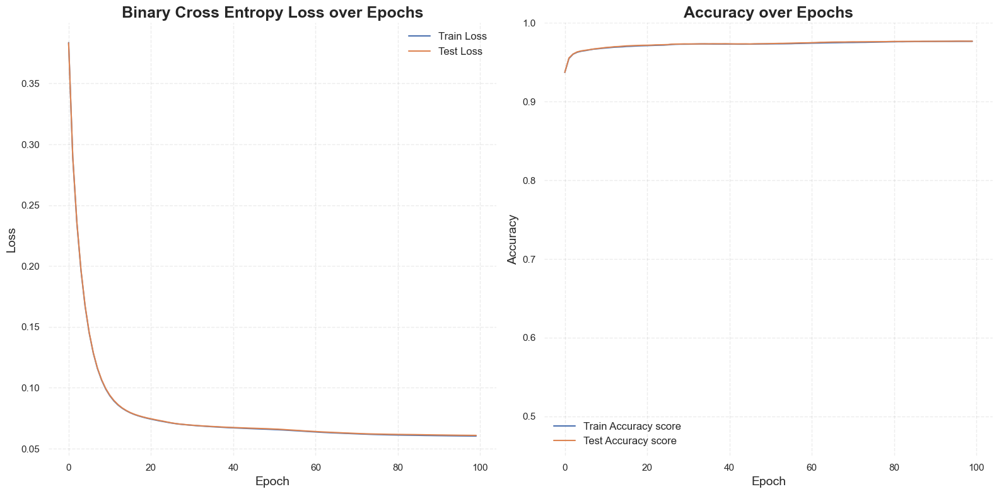

In [8]:
# Plot the metrics history
MLP_plot(metrics_history, n_epoch)

### <code style="background:royalblue;color:white">**Model Selection and Conclusions**</code>  

In light of the excellent performance of all models, it could be said that each would be fine as a solution to our problem. While this may be true there are some considerations to be made that, in my opinion, make some solutions preferable over the others. 

- The first consideration is that logistic regression although it works well with this dataset is probably an overly simplistic solution that would not be able to account for possible potentially relevant nonlinear relationships with less valid data than those used this time. 

- The SVC although excellent requires far too much time to hypertuning it with nonlinear kernels so I would not consider it a viable solution unless training time is not a relevant parameter for model selection. 

- The Random Forest also suffers from the same problem of SVC although in much lower intesity. 

- The ExtraTreeClassifier and XGBoost manage to achieve excellent results in a short time proving to be very good models. 

- The MLP does not achieve excellence in terms of absolute score (although with a really negligible loss of about 2%) but it is the one that probably showed the fastest convergence. 

In light of these conclusions I would consider all 3 to be excellent candidates for a test on different, perhaps less accurate, data to see which proves to be the most flexible and performant. Having to choose only one, however, I would prefer the MLP given its small need for hypertuning to achieve excellent results.

Thanks to the constant null differential between the metrics in the train set and the test set, we can draw some conclusions about the dataset used:

- The data are very representative and the fact that the two classes are balanced (even if the Fraud event is a rare event) allows the model to learn the patterns very well without overfitting.
